In [19]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import matplotlib.image
import seaborn as sns

import torch
import torchaudio

import random
from glob import glob

import librosa
import librosa.display
#import ffprobe
#import ffmpeg
import stempeg
import IPython.display as ipd

import musdb
import scipy
from scipy import signal
from scipy.io import wavfile
from scipy.fft import fftshift

from itertools import cycle
from scipy.io.wavfile import write

from ipywidgets import interact, interactive, fixed, interact_manual

import os

sns.set_theme(style="white", palette=None)
color_pal = plt.rcParams["axes.prop_cycle"].by_key()["color"]
color_cycle = cycle(plt.rcParams["axes.prop_cycle"].by_key()["color"])

In [56]:
stem_file_path = "../musdb-copy/train"
stem_files = glob(stem_file_path + "/*.stem.mp4")

In [57]:
print("Number of stem files: ", len(stem_files))
print("Track dymentions: ", stempeg.read_stems(stem_files[0])[0].shape)
print("File names:")
for i in range(5):
    print(stem_files[i])
print("...")

Number of stem files:  8
Track dymentions:  (5, 7299072, 2)
File names:
../musdb-copy/train\ANiMAL - Rockshow.stem.mp4
../musdb-copy/train\Atlantis Bound - It Was My Fault For Waiting.stem.mp4
../musdb-copy/train\Auctioneer - Our Future Faces.stem.mp4
../musdb-copy/train\AvaLuna - Waterduct.stem.mp4
../musdb-copy/train\BigTroubles - Phantom.stem.mp4
...


In [58]:
stems_1, sample_rate = stempeg.read_stems(stem_files[0])

In [59]:
sample_rate

44100

In [60]:
stems_1.shape

(5, 7299072, 2)

In [85]:
track_1 = stems_1[1, :, :]

In [86]:
track_1.shape[0] / sample_rate / 60

2.758530612244898

## STFT and Sprektrograms

In [90]:
track_1.shape

(7299072, 2)

In [91]:
y, sr = track_1, sample_rate

y = np.mean(y, axis=1)
y.shape



(7299072,)

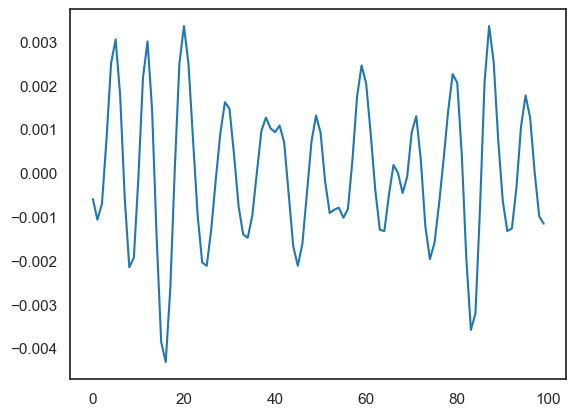

In [84]:
plt.plot(y[100:200])

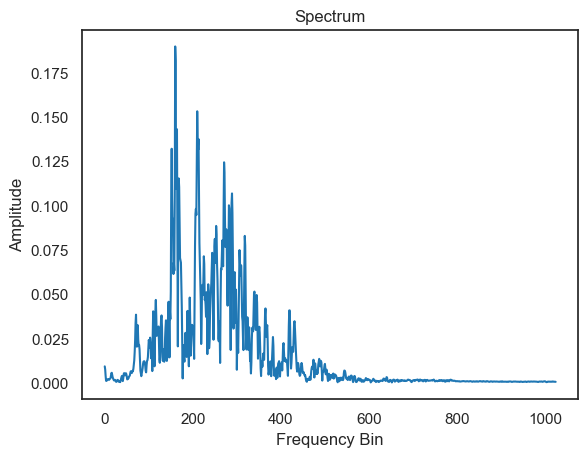

In [75]:
n_fft = 2048
ft = np.abs(librosa.stft(y[:n_fft], hop_length = n_fft+1))
plt.plot(ft);
plt.title('Spectrum');
plt.xlabel('Frequency Bin');
plt.ylabel('Amplitude');

Text(0.5, 1.0, 'Spectrogram')

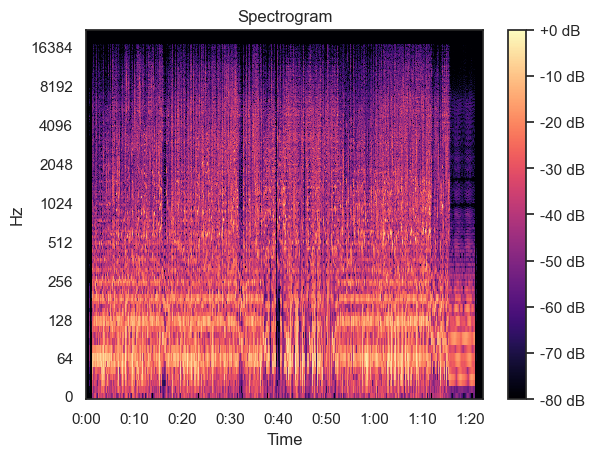

In [127]:
spec = np.abs(librosa.stft(wave, n_fft=4096 ,hop_length=1024))
spec = librosa.amplitude_to_db(spec, ref=np.max)
librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram')

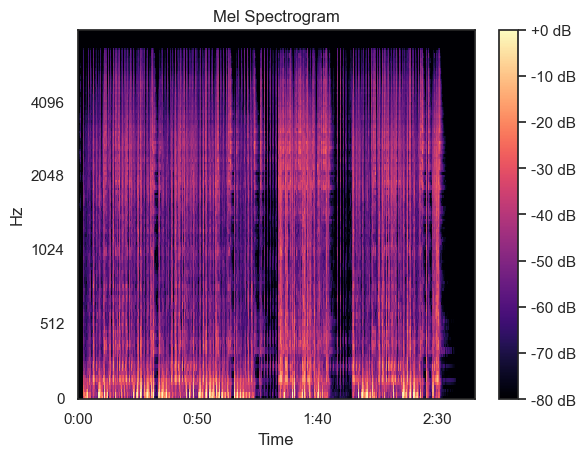

In [126]:
mel_spect = librosa.feature.melspectrogram(y=y, sr=sr, n_fft=4096, hop_length=1024)
mel_spect = librosa.power_to_db(mel_spect, ref=np.max)
librosa.display.specshow(mel_spect, y_axis='mel', fmax=8000, x_axis='time')
plt.title('Mel Spectrogram')
plt.colorbar(format='%+2.0f dB')

In [ ]:
mel_spect = librosa.feature.melspectrogram(y=y, sr=sr, n_fft=2048, hop_length=1024)
mel_spect = librosa.power_to_db(mel_spect, ref=np.max)
librosa.display.specshow(mel_spect, y_axis='mel', fmax=8000, x_axis='time')
plt.title('Mel Spectrogram')
plt.colorbar(format='%+2.0f dB')

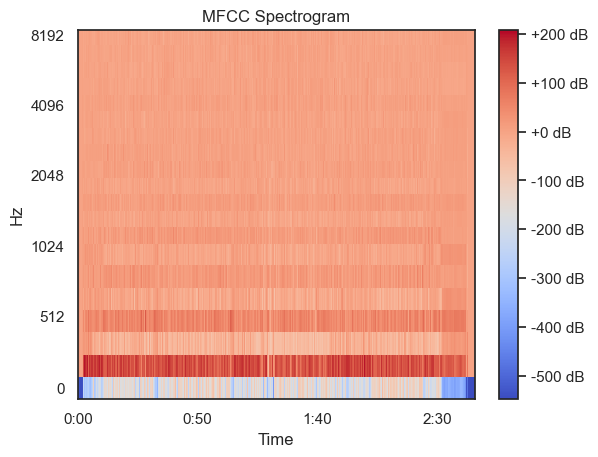

In [78]:
mfcc_spect = librosa.feature.mfcc(y=y, sr=sr, n_fft=2048, hop_length=1024)
#mfcc_spect = librosa.power_to_db(mfcc_spect, ref=np.max)
librosa.display.specshow(mfcc_spect, y_axis='mel', fmax=8000, x_axis='time')
plt.title('MFCC Spectrogram')
plt.colorbar(format='%+2.0f dB')

In [79]:
spec.shape

(2049, 14257)

In [43]:

track_1_trim, y_trim = librosa.effects.trim(track_1[0, :, 0], top_db = 15)

In [47]:
ipd.Audio(np.array(track_1[0, :, 0]), rate= 44100)

In [48]:
ipd.Audio(np.array(track_1_trim), rate= 44100)

In [49]:
# N = 2
# track = stempeg.read_stems(stem_files[N])

# print(stem_files[N])

# waveform = track[0][0]
# ipd.display(ipd.Audio(waveform.T, rate=44100))

'''
    TRACK ORDER:
        Mix
        Drums
        Bass
        Other
        Voice
'''

'\n    TRACK ORDER:\n        Mix\n        Drums\n        Bass\n        Other\n        Voice\n'

In [38]:
stems, sr = stempeg.read_stems(stem_files[0])

In [44]:
wave = stems[0]
wave = np.mean(wave, axis=1)
wave.shape

(7299072,)

## Formiranje Nove Baze - Baza Spektrograma

In [97]:
stem_file_path = "../musdb-copy"
train_test = ["/train", "/test"]
stem_files = glob(stem_file_path + train_test[0] + "/*.stem.mp4")

In [98]:
len(stem_files)

8

In [89]:
SAMPLE_RATE = 44100
TARGET_SAMPLE_RATE = SAMPLE_RATE // 3
NEW_DIR = "../data_cut"

if(not os.path.isdir(NEW_DIR)):
    os.mkdir(NEW_DIR)
    os.mkdir(NEW_DIR + "/train")
    os.mkdir(NEW_DIR + "/test")

In [105]:
track_index_names = {0: "mix", 1: "drums", 2: "bass", 3: "other", 4: "vocals"}

#### Formiranje Isecaka

In [21]:
# Cut the files into 30 seconds long pieces
stem_file_path = "../musdb-copy"
train_test = ["/train", "/test"]
#TOP_DB = 15

track_index_names = {0: "mix", 1: "drums", 2: "bass", 3: "other", 4: "vocals"}
track_names = ["mix", "drums", "bass", "other", "vocals"]

SAMPLE_RATE = 44100
#TARGET_SAMPLE_RATE = SAMPLE_RATE // 3
NEW_DIR = "../data_cut"

if os.path.exists(NEW_DIR):
    for folder in train_test:
        for f in glob(NEW_DIR + folder + "/*"):
            os.remove(f)
        os.rmdir(NEW_DIR + folder)
    os.rmdir(NEW_DIR)
    
if(not os.path.isdir(NEW_DIR)):
    os.mkdir(NEW_DIR)
    os.mkdir(NEW_DIR + "/train")
    os.mkdir(NEW_DIR + "/test")

for folder in range(len(train_test)):

    stem_files = glob(stem_file_path + train_test[folder] + "/*.stem.mp4")
    length = len(stem_files)
    
    for i in range(length):
        stems, sample_rate = stempeg.read_stems(stem_files[i])

        for instrument in range(5):
            audio = stems[instrument]
            print(audio.shape)

            wavfile.write(filename=NEW_DIR + train_test[folder] + "/" + str(i) + "_" + track_index_names[instrument] + ".wav", rate=SAMPLE_RATE, data=audio)
            
            print(train_test[folder], " : ", i + 1, "out of", length, "files", end='\r')

print("Done!") 

        #_, y_trim = librosa.effects.trim(stems[0].T[0, :, 0], top_db = TOP_DB)
        #print(y_trim)
"""
        #print("Ucitana pesma broj", i, " od ", len(stem_files), " pesama")
        for j in range(5):
            track = stems[0][j]
            track_name = track_index_names[j]

            
        
            track_trim = track[y_trim[0]:y_trim[1], :]

            track_ds = track_trim[1::4, :]
            # Converstereo track to mono
            track_ds = np.mean(track_ds, axis=1)
            # Cut the track into 30 seconds long pieces

            write(NEW_DIR + train_test[folder] + "/" + str(i) + "_" + track_name + ".wav", SAMPLE_RATE, track_ds)

            # for k in range(0, track_ds.shape[0], TARGET_SAMPLE_RATE * 30):
            #     if(k + TARGET_SAMPLE_RATE * 30 < track_ds.shape[0]):    
            #         track_cut = track_ds[k:k + TARGET_SAMPLE_RATE * 30]
            #         # Save the track
            #         write(NEW_DIR + train_test[folder] + "/" + str(i) + "_" + str(int(k / (30 * TARGET_SAMPLE_RATE))) + "_" + track_name + ".wav", SAMPLE_RATE // 9, track_cut)
            #         #print(folder,": Saved track (", track_name, ") from song", i + 1, "part", int(k / (30 * TARGET_SAMPLE_RATE)))
            #         print(train_test[folder], " : ", i + 1, "out of", length, "files", end='\r') 
            #     else:
            #         break


"""     


            

(7299072, 2)
(7299072, 2) out of 8 files
(7299072, 2) out of 8 files
(7299072, 2) out of 8 files
(7299072, 2) out of 8 files
(11821056, 2)out of 8 files
(11821056, 2)out of 8 files
(11821056, 2)out of 8 files
(11821056, 2)out of 8 files
(11821056, 2)out of 8 files
(9159680, 2) out of 8 files
(9159680, 2) out of 8 files
(9159680, 2) out of 8 files
(9159680, 2) out of 8 files
(9159680, 2) out of 8 files
(11426816, 2)out of 8 files
(11426816, 2)out of 8 files
(11426816, 2)out of 8 files
(11426816, 2)out of 8 files
(11426816, 2)out of 8 files
(6471680, 2) out of 8 files
(6471680, 2) out of 8 files
(6471680, 2) out of 8 files
(6471680, 2) out of 8 files
(6471680, 2) out of 8 files
(10175488, 2)out of 8 files
(10175488, 2)out of 8 files
(10175488, 2)out of 8 files
(10175488, 2)out of 8 files
(10175488, 2)out of 8 files
(17575936, 2)out of 8 files
(17575936, 2)out of 8 files
(17575936, 2)out of 8 files
(17575936, 2)out of 8 files
(17575936, 2)out of 8 files
(12280832, 2)out of 8 files
(122808

'\n        #print("Ucitana pesma broj", i, " od ", len(stem_files), " pesama")\n        for j in range(5):\n            track = stems[0][j]\n            track_name = track_index_names[j]\n\n            \n        \n            track_trim = track[y_trim[0]:y_trim[1], :]\n\n            track_ds = track_trim[1::4, :]\n            # Converstereo track to mono\n            track_ds = np.mean(track_ds, axis=1)\n            # Cut the track into 30 seconds long pieces\n\n            write(NEW_DIR + train_test[folder] + "/" + str(i) + "_" + track_name + ".wav", SAMPLE_RATE, track_ds)\n\n            # for k in range(0, track_ds.shape[0], TARGET_SAMPLE_RATE * 30):\n            #     if(k + TARGET_SAMPLE_RATE * 30 < track_ds.shape[0]):    \n            #         track_cut = track_ds[k:k + TARGET_SAMPLE_RATE * 30]\n            #         # Save the track\n            #         write(NEW_DIR + train_test[folder] + "/" + str(i) + "_" + str(int(k / (30 * TARGET_SAMPLE_RATE))) + "_" + track_name + ".wav"

In [26]:
# Load stereo wav file at location '../data_cut/train/0_mix.wav'

# Load wav file
sr, mix = wavfile.read(filename='../data_cut/train/0_mix.wav')
mix.shape


(7299072, 2)

In [95]:


matplotlib.image.imsave('./mel_spectrogra_test.png', mel_spect)

#### Forming the spectrogram database

In [40]:
# Cut the files into 30 seconds long pieces
stem_file_path = "../data"
train_test = ["/train", "/test"]
#TOP_DB = 15

track_index_names = {0: "mix", 1: "drums", 2: "bass", 3: "other", 4: "vocals"}
track_names = ["mix", "drums", "bass", "other", "vocals"]

SAMPLE_RATE = 44100
#TARGET_SAMPLE_RATE = SAMPLE_RATE // 3
NEW_DIR = "../data_wav"

if os.path.exists(NEW_DIR):
    for folder in train_test:
        for fol in range(5):
            for file in glob(NEW_DIR + folder + "/" + track_index_names[fol] + "/*"):
                os.remove(file)
            os.rmdir(NEW_DIR + folder + "/" + track_index_names[fol])
        os.rmdir(NEW_DIR + folder)
    os.rmdir(NEW_DIR)
    
if(not os.path.isdir(NEW_DIR)):
    os.mkdir(NEW_DIR)
    os.mkdir(NEW_DIR + "/train")
    os.mkdir(NEW_DIR + "/train" + "/mix")
    os.mkdir(NEW_DIR + "/train" + "/drums")
    os.mkdir(NEW_DIR + "/train" + "/bass")
    os.mkdir(NEW_DIR + "/train" + "/vocals")
    os.mkdir(NEW_DIR + "/train" + "/other")
    os.mkdir(NEW_DIR + "/test")
    os.mkdir(NEW_DIR + "/test" + "/mix")
    os.mkdir(NEW_DIR + "/test" + "/drums")
    os.mkdir(NEW_DIR + "/test" + "/bass")
    os.mkdir(NEW_DIR + "/test" + "/vocals")
    os.mkdir(NEW_DIR + "/test" + "/other")

for folder in range(len(train_test)):
    stem_files = glob(stem_file_path + train_test[folder] + "/*.stem.mp4")  
    length = len(stem_files)
    
    for i in range(length):
        stems, sample_rate = stempeg.read_stems(stem_files[i])
        for instrument in range(5):
            audio = stems[instrument]

            name = str(i + folder * 100) + "_" + track_index_names[instrument]
            if(i < 10):
                name = '0' + name
                
            wavfile.write(filename=NEW_DIR + train_test[folder] + "/" + track_index_names[instrument]
                          + "/" + name + ".wav",
                          rate=SAMPLE_RATE, data=audio)
        
        print(train_test[folder], " : ", i + 1, "out of", length, "files", end='\r')

print("                                            ", end='\r')
print("Done!", end='\r') 

            

In [41]:
img = np.load(file='../data_spect/train/0_bass_spect.npy')
img.shape

(2, 2049, 7129)

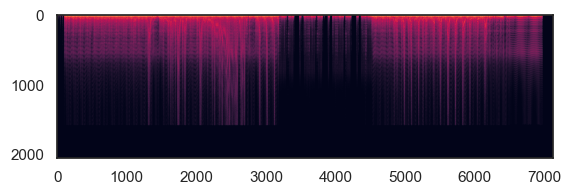

In [44]:
plt.imshow(img[0])
plt.show()

In [45]:
# Cut the files into 30 seconds long pieces
stem_file_path = "../data_wav"
train_test = ["/train", "/test"]
#TOP_DB = 15

track_index_names = {0: "mix", 1: "drums", 2: "bass", 3: "other", 4: "vocals"}
track_names = ["mix", "drums", "bass", "other", "vocals"]

SAMPLE_RATE = 44100
#TARGET_SAMPLE_RATE = SAMPLE_RATE // 3
NEW_DIR = "../data_spect"

# If the folder exists, delete it and create a new one
if os.path.exists(NEW_DIR):
    for folder in train_test:
        for fol in range(5):
            for file in glob(NEW_DIR + folder + "/" + track_index_names[fol] + "/*"):
                os.remove(file)
            os.rmdir(NEW_DIR + folder + "/" + track_index_names[fol])
        os.rmdir(NEW_DIR + folder)
    os.rmdir(NEW_DIR)
    
if(not os.path.isdir(NEW_DIR)):
    os.mkdir(NEW_DIR)
    os.mkdir(NEW_DIR + "/train")
    os.mkdir(NEW_DIR + "/train" + "/mix")
    os.mkdir(NEW_DIR + "/train" + "/drums")
    os.mkdir(NEW_DIR + "/train" + "/bass")
    os.mkdir(NEW_DIR + "/train" + "/vocals")
    os.mkdir(NEW_DIR + "/train" + "/other")
    os.mkdir(NEW_DIR + "/test")
    os.mkdir(NEW_DIR + "/test" + "/mix")
    os.mkdir(NEW_DIR + "/test" + "/drums")
    os.mkdir(NEW_DIR + "/test" + "/bass")
    os.mkdir(NEW_DIR + "/test" + "/vocals")
    os.mkdir(NEW_DIR + "/test" + "/other")


for folder in range(len(train_test)):
    for instrument in range(5):
        wav_files = glob(stem_file_path + train_test[folder] + '/' + track_index_names[instrument] + "/*.wav")
        length = len(wav_files)
        wav_file_paths_end = [os.path.split(wav_file)[1] for wav_file in wav_files]
        
        for i in range(length):
            #stems, sample_rate = stempeg.read_stems(stem_files[i])
            sample_rate, audio = wavfile.read(wav_files[i])
    
            #print(audio.shape)
            spectrogram = np.abs(librosa.stft(audio.T, n_fft=4096, hop_length=1024))
            spectrogram = librosa.amplitude_to_db(spectrogram, ref=np.max)
    
            # Cut sprectrogram into pieces 2 x 1536 x 256
            
            spectrogram = spectrogram[:, :1536, :]
            PIECE_LENGTH = 256
    
            num_of_slices = spectrogram.shape[-1] // PIECE_LENGTH
            
            for j in range(num_of_slices):

                name =  wav_file_paths_end[i].split('.')[0] + "_spect_" + str(j)
                if j < 10:
                    name =  wav_file_paths_end[i].split('.')[0] + "_spect_" + '0' + str(j)
                
                cut = spectrogram[:, :, j * PIECE_LENGTH : (j + 1) * PIECE_LENGTH]
                np.save(file=NEW_DIR + train_test[folder] + '/' + track_index_names[instrument] +
                        "/" + name, arr=cut)

            if folder == 0:
                curr_file_print_idx = instrument * 100 + i + 1
            else:
                curr_file_print_idx = 500 + instrument * 50 + i + 1
            
            print(train_test[folder], " : ", curr_file_print_idx, "out of", 750, "files", end='\r')

print("                                            ", end='\r')
print("Done!", end='\r')
            
            


(2, 1536, 256)


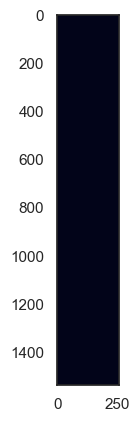

In [56]:
img = np.load('../data_spect/train/1_bass_spect_44.npy')
print(img.shape)
plt.imshow(img[0])